In [ ]:
                                                                     # A simple generic DVR
                                                    # The quantum mechaanical problem into consideration is :
                                         #"1-D Quantum system with coordinate x restricted to the interval (a,b)"
                                # For,  (a,b)=(-infinty,+infinity)                   -----QM Problem With Double Well Potential

# The grid point reperesentaion (matrix representation) of the kinetic energy operator is as follows:

import numpy as np
a=-20
b=20
def f(m, n):
    if m == n:
        d = 3.2898681337
    else:
        d = 2 / (m - n) ** 2
    c = (0.5 / d_x ** 2) * float((-1) ** (m - n)) * float(d)
    return c
r = 300   #Number of Basis Functions will be 2r, whereas number of diagonal entries will be (2r+1), in which the middlemost entry of the square matrix (that willl be formed) will be 0.
column = []
d_x = (b-a) /(2*r+1)
for m in range(-r, r + 1):
    rows = []
    for n in range(-r, r + 1):
        u = f(m, n)
        rows.append(u)
    column.append(rows)
M = np.array(column)
#reserved---->a,b,c,d,t,m,n,r,M,u



In [ ]:
# The grid point representation (matrix representation) of potential energy operator is as follows:

A=0.00008
B=0.025
def v(x):
    z = A*(x**4) -B*(x**2)
    return z
x_p = np.arange(a,b,d_x)
y_p=[]
for x in x_p:
    y_p.append(v(x))

N = np.diag(y_p)

#reserved---->a,b,c,d,t,m,n,r,u,M,A,B,v,z,u,N

In [ ]:
# The grid point representation (Matrix representation) of Hamiltonian is as follows:

H = M + N
E, psi = np.linalg.eigh(H)

#reserved---->a,b,c,d,t,m,n,r,u,M,A,B,v,z,u,N,H,E

Text(0, 0.5, 'Psi(x)')

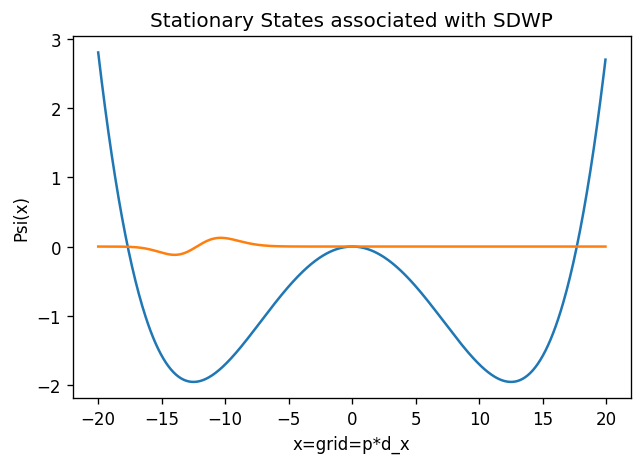

In [ ]:
#PLotting Time Indepdendent Wave Function:

import matplotlib.pyplot as plt
y = psi[:,2]

plt.figure(num=0, dpi=120)
plt.plot(x_p,y_p)
plt.plot(x_p,y)
plt.title("Stationary States associated with SDWP")
plt.xlabel("x=grid=p*d_x")
plt.ylabel("Psi(x)")
# We are only getting limited no. of bound staes because oue boundries are not (-infinity, infinity) but (a,b)

#reserved---->a,b,c,d,t,m,n,r,u,M,A,B,v,z,x,N,H,E,y

In [ ]:
##assining values to different constants present in our initial wavepacket
k0=m/2
x0=485
sigma=0.8

x=x_p
#Initial Wavepacket
psi_0=np.ones(len(x),dtype=complex)
psi_0*=1/(sigma*np.sqrt(2*np.pi))
psi_0*=np.exp(-0.5*((x-x0)/sigma)**2)
psi_0*=np.exp(1j*k0*x)


In [ ]:
#Calculating the time indepedndent coefficients associated with stationary states
Nx=2*r+1
Nt=10000
def c_k(k):
  c_k=np.dot(psi_0,(psi[:,k].T))
  return c_k
#reserved---->a,b,c,d,t,m,n,r,u,M,A,B,v,z,x,N,H,E,y,k

In [ ]:
def C(t,k):
  C=c_k(k)*np.exp(-E[k]*1j*t)
  return C

#reserved---->a,b,c,d,f,m,n,r,u,M,A,B,v,z,x,N,H,E,y,k,C

In [ ]:
def function(t):
  j=0
  sum=0
  while j<601:
    sum=sum+C(t,j)*psi[:,j]
    j=j+1
  return sum
#reserved---->a,b,c,d,f,m,n,r,u,M,A,B,v,z,x,N,H,E,y,k,C,i,j

In [ ]:
final=np.zeros([Nt,Nx]).astype(complex)
final[0]=psi_0
print(final)

[[ 7.56354798e-07+0.j  1.67848080e-06+0.j  2.64294180e-06+0.j ...
  -1.12625944e-12+0.j -6.20115450e-13+0.j -4.68305324e-13+0.j]
 [ 0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j ...
   0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j]
 [ 0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j ...
   0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j]
 ...
 [ 0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j ...
   0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j]
 [ 0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j ...
   0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j]
 [ 0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j ...
   0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j]]


In [ ]:
for t in range(1,Nt):
  final[t]=function(t)
#reserved---->a,b,c,d,f,m,n,r,u,M,A,B,v,z,x,N,H,E,y,k,C,i,j,t

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1317: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


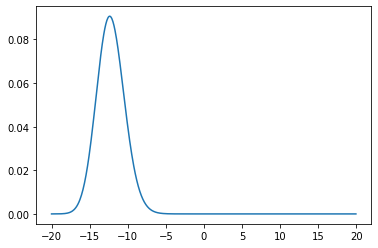

In [ ]:
y_f=final[3]
x_f=x_p#np.arange(0,10000,1)
#plt.plot(x_f,y_p)
plt.plot(x_f,y_f)

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

t1=np.arange(0,601,1)
x1=np.arange(0,601,1)

T,X=np.meshgrid(t1,x1)
F=np.absolute(final[t1][x1])**2

def plotter(E,A):
 fig=plt.figure(figsize=[10,4])
 ax=fig.gca(projection='3d')
 ax.plot_surface(T,X,F,cmap=cm.coolwarm)
 ax.view_init(elev=E,azim=A)
 ax.set_xlabel('x')
 ax.set_ylabel('t')
 ax.set_zlabel('Psi(x,t)')
 plt.show()
from ipywidgets import interactive
iplot=interactive(plotter,
                  E=(-180,180,5),
                  A=(-180,180,5))
iplot

interactive(children=(IntSlider(value=0, description='E', max=180, min=-180, step=5), IntSlider(value=0, descr…

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1317: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


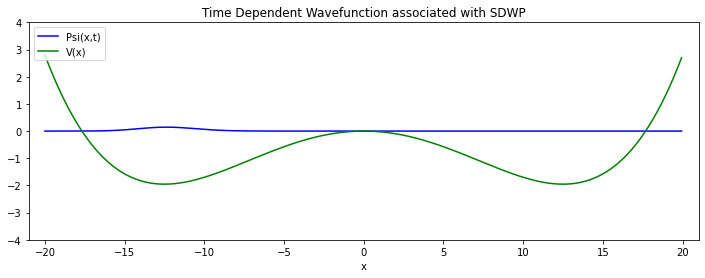

In [ ]:
from matplotlib.animation import FuncAnimation
def animate(i):
  ln1.set_data(x_f,final[i])
  ln2.set_data(x_p,y_p)
fig,ax=plt.subplots(figsize=(12,4))
ln1,=plt.plot([],[],'b-',label='Psi(x,t)')
ln2,=plt.plot([],[],'g-',label='V(x)')
ax.set_ylim(-4,4)
ax.set_xlim(-21,21)
ax.set_xlabel('x')
ax.set_title('Time Dependent Wavefunction associated with SDWP')
ax.legend(loc='upper left')
anim=FuncAnimation(fig,animate,frames=601, interval=100)
anim.save('plot.mp4')

In [ ]:
plt.rcParams['animation.html']='jshtml'
anim

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1317: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
